# Using Harris Corner Detection and Normalised Image Patches to stitch images

Authors:

Oisin Watkins - 15156176

Reezvee Sikder - 15140997

Patrick Lu - 15154149

Introduction:

The following report details the code written and tested by the above listed students. In accordance with the project outline given on Sulis, this code impliments as Harris Corner Detection algorithm, which will then be used to stitch two matching images together. The performance of this algorithm is to be evaluated accordingly (runtime, robustness, output credibility). Furthermore, certain elements of this algorithm are to be tested for rotation invariance and scale invariance.
    
First and foremost, all relevant imports:

In [1]:
import cv2
import numpy as np
from numpy import linalg as la
from scipy import ndimage
from scipy.ndimage import zoom

# Harris Corner Detection Function

In [2]:
"""
Implements a Harris Corner detector, all steps have been implemented globally across the entire input image

Functions accepts an ndarray version of the png of interest
Returns a thresholded, Non-Max Suppressed Harris Response (r, c) list of all harris interest points
 
Trial and error eventually found sigma values for both of the gaussian_filter calls which stiched all images
together satisfactorilly. The balloon image did have a slight vertical mismatch. Under testing this algorithm
was very sensitive to the sigma values used, however these values proved most reliable

"""


def harrisCorner(img):
    
    # Convert Image to greyscale
    grey = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    grey = np.float32(grey)
    
    # Differentiate along rows and columns seperately, sigma value was set using trial and error for each image set
    Ix = ndimage.gaussian_filter(grey, sigma=1, order=(0, 1))
    Iy = ndimage.gaussian_filter(grey, sigma=1, order=(1, 0))
    Ix2 = np.power(Ix, 2)
    Iy2 = np.power(Iy, 2)
    
    # Compute all variables of interest for the entire image in one pass
    A = ndimage.gaussian_filter(Ix2, sigma=1.8, order=0)
    B = ndimage.gaussian_filter(Iy2, sigma=1.8, order=0)
    C = ndimage.gaussian_filter(np.multiply(Ix, Iy), sigma=2, order=0)

    detM = np.subtract(np.multiply(A, C), np.power(B, 2))
    trM = np.add(np.add(A, C), 0.000001)  # Tiny positive offset used to cancel any potential 0 values (occur in flat regions)
    R = np.divide(detM, trM)  # Use Harmonic mean approximation
    R_th = (R > 0.01*R.max())  # Threshold at 1% the maximum value

    # Perform non-maximum suppressions
    coords = np.array(R_th.nonzero()).T
    candidate_values = np.array([R[c[0], c[1]] for c in coords])
    indices = np.argsort(candidate_values)

    allowed_locations = np.zeros(R.shape)
    allowed_locations[10:-10, 10:-10] = 1

    filtered_coords = []  # array to return the (r, c) locations of all non-max suppressed harris interets points
    for i in indices[::-1]:
        r, c = coords[i]
        if allowed_locations[r, c]:
            filtered_coords.append((r, c))
            allowed_locations[r-10:r+11, c-10:c+11] = 0

    return filtered_coords

# Image Stitching Function (uses Normalised Image Patch Vectors)

In [3]:
"""
Function which matches Harris interest points in 2 images, then stitches those 2 images together into a mosaic

Accepts 2 cv2.imread('') images and 2 corresponding (r, c) lists of Harris Interest Points 

Due to the implementation of exhaustive RANSAC this function can run extremely slowly if the number of
potential translations as detected by the patch-vector analysis is quite large. Perhaps a more robust
interest point comparrison would negate this speed issue
"""


def mergeImages(image1, image2, harris1, harris2):

    Img1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    Img2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)  # Convert both images to greyscale
    Harris1 = np.array(harris1)
    Harris2 = np.array(harris2)  # Convert (r, c) lists to numpy ndarrays
    rows1, cols1 = Harris1.shape
    rows2, cols2 = Harris2.shape  # Ascertain size of harris interst point lists

    # initialise image patch matrices -> 11x11 window used, hence 121 columns needed
    img1PatchVectors = np.zeros([rows1, 121])
    img2PatchVectors = np.zeros([rows2, 121])

    for i in range(rows1):
        # 11x11 patch around point of interest
        window = Img1[Harris1[i, 0] - 5:Harris1[i, 0] + 6, Harris1[i, 1] - 5:Harris1[i, 1] + 6]
        window = np.reshape(window, (1, 121))  # Flatten patch into vector
        window = np.divide(np.subtract(window, np.mean(window)), la.norm(window)) # Turn vector into 0-mean unit vector

        img1PatchVectors[i, :] = window  # insert into array

    for i in range(rows2):
        # 11x11 patch around point of interest
        window = Img2[Harris2[i, 0] - 5:Harris2[i, 0] + 6, Harris2[i, 1] - 5:Harris2[i, 1] + 6]
        window = np.reshape(window, (1, 121))  # Flatten patch into vector
        window = np.divide(np.subtract(window, np.mean(window)), la.norm(window))  # Turn vector into 0-mean unit vector

        img2PatchVectors[i, :] = window  # insert into array

    img1PatchVectors = img1PatchVectors[~np.all(img1PatchVectors == 0, axis=1)]
    img2PatchVectors = img2PatchVectors[~np.all(img2PatchVectors == 0, axis=1)]  # Remove any row populated only with zeros

    R = np.dot(img1PatchVectors, np.transpose(img2PatchVectors))  # compute response matrix
    R[R > 0.9*R.max()] = 0  # Threshold applied at 0.9*maximum value

    rowsOfInterest, colsOfInterest = np.nonzero(R)  # Extract indices of remaining translation responses
    numPoints = len(rowsOfInterest)  # no. translations recorded

    translations = np.zeros((numPoints, 2))  # stores the dx and dy info of each ranslation
    a = np.zeros((numPoints, 2))  # stores the image one interest point co-ordinates
    b = np.zeros((numPoints, 2))  # stores the corresponding image 2 interest point co-ordinates
    for i in range(numPoints):
        a[i] = Harris1[rowsOfInterest[i], :]
        b[i] = Harris2[colsOfInterest[i], :]
        translations[i] = [a[i, 0] - b[i, 0], a[i, 1] - b[i, 1]]  # compute image1 coords, image2 coords and their translation

    # Implement exhaustive RANSAC on all translations
    agreementCount = np.zeros((translations.shape[0]))  # Initialise array to track support for each translation
    for i in range(translations.shape[0]):
        
        # select a candidate iteratively
        candidate = translations[i, :]
        
        # build opposition from the remaining translations
        opposition = translations[~np.all(translations == translations[i, :], axis=1)]
        
        for j in range(opposition.shape[0]):
            
            # calculate euclidean distance between translation endpoints
            euclidDist = np.power(np.add(np.power(np.subtract(candidate[0], opposition[j, 0]), 2),
                                         np.power(np.subtract(candidate[1], opposition[j, 1]), 2)), 0.5)
            if euclidDist <= 1:  # if the translations have endpoints less than 1 pixel apart they are considered in agreement
                agreementCount[i] = agreementCount[i] + 1  # increment corresponding agreement counter
                
    # find all maximally supported translations (May return more than one, all are considered good enough)
    bestCandidate = np.where(agreementCount == np.amax(agreementCount))
    
    # Take all translation vectors which correspond to these highly supported indices
    avgTranslation = translations[bestCandidate, :]

    # The following if-elif... block determines where to place each image w.r.t. the other image, ie: where should
    # image 1 be initialised to and where in relation to image 1 should image 2 be?
 
    if avgTranslation[0, 0, 0] > 0 and avgTranslation[0, 0, 1] > 0:
        output = np.zeros((image2.shape[0] + np.absolute(avgTranslation[0, 0, 0]).astype(int), image2.shape[1] + np.absolute(avgTranslation[0, 0, 1]).astype(int), 3))  # initialise output to the necessary size

        output[0:image1.shape[0], 0:image1.shape[1]] = image1  # image1 initialised to top left of output
        output[output.shape[0]-image2.shape[0]:output.shape[0], output.shape[1]-image2.shape[1]:output.shape[1]] = image2  # image2 to Bottom Right

    elif avgTranslation[0, 0, 0] < 0 and avgTranslation[0, 0, 1] > 0:
        output = np.zeros((image1.shape[0] + np.absolute(avgTranslation[0, 0, 0]).astype(int), image2.shape[1] + np.absolute(avgTranslation[0, 0, 1]).astype(int), 3))  # initialise output to the necessary size

        output[output.shape[0]-image1.shape[0]:output.shape[0], 0:image1.shape[1]] = image1  # image1 initialised to bottom left of output
        output[0:image2.shape[0], output.shape[1]-image2.shape[1]:output.shape[1]] = image2  # image2 to top right

    elif avgTranslation[0, 0, 0] > 0 and avgTranslation[0, 0, 1] < 0:
        output = np.zeros((image2.shape[0] + np.absolute(avgTranslation[0, 0, 0]).astype(int), image1.shape[1] + np.absolute(avgTranslation[0, 0, 1]).astype(int), 3))  # initialise output to the necessary size

        output[0:image1.shape[0], output.shape[1]-image1.shape[1]:output.shape[1]] = image1  # image1 initialised to top right of output
        output[output.shape[0]-image2.shape[0]:output.shape[0], 0:image2.shape[1]] = image2  # image2 to bottom left

    else:
        output = np.zeros((image1.shape[0] + np.absolute(avgTranslation[0, 0, 0]).astype(int), image1.shape[1] + np.absolute(avgTranslation[0, 0, 1]).astype(int), 3))  # initialise output to the necessary size

        output[output.shape[0]-image1.shape[0]:output.shape[0], output.shape[1]-image1.shape[1]:output.shape[1]] = image1  # image1 initialised to bottom right of output
        output[0:image2.shape[0], 0:image2.shape[1]] = image2  # image2 to top left
        
    output_uint = output.astype(np.uint8)  # save the output image as unsigned 8-bit integer for cv2 to print
    return output_uint

# Zoom Function (used to test Scale variance later on)

In [4]:
def clipped_zoom(img, zoom_factor, **kwargs):

    h, w = img.shape[:2]

    # For multichannel images we don't want to apply the zoom factor to the RGB
    # dimension, so instead we create a tuple of zoom factors, one per array
    # dimension, with 1's for any trailing dimensions after the width and height.
    zoom_tuple = (zoom_factor,) * 2 + (1,) * (img.ndim - 2)

    # Zooming out
    if zoom_factor < 1:

        # Bounding box of the zoomed-out image within the output array
        zh = int(np.round(h * zoom_factor))
        zw = int(np.round(w * zoom_factor))
        top = (h - zh) // 2
        left = (w - zw) // 2

        # Zero-padding
        out = np.zeros_like(img)
        out[top:top+zh, left:left+zw] = zoom(img, zoom_tuple, **kwargs)

    # Zooming in
    elif zoom_factor > 1:

        # Bounding box of the zoomed-in region within the input array
        zh = int(np.round(h / zoom_factor))
        zw = int(np.round(w / zoom_factor))
        top = (h - zh) // 2
        left = (w - zw) // 2

        out = zoom(img[top:top+zh, left:left+zw], zoom_tuple, **kwargs)

        # `out` might still be slightly larger than `img` due to rounding, so
        # trim off any extra pixels at the edges
        trim_top = ((out.shape[0] - h) // 2)
        trim_left = ((out.shape[1] - w) // 2)
        out = out[trim_top:trim_top+h, trim_left:trim_left+w]

    # If zoom_factor == 1, just return the input array
    else:
        out = img
    return out

# Read .png files and perform routine seperately for each image pair

In [5]:
archFile1 = './arch1.png'
archFile2 = './arch2.png'
balloonFile1 = './balloon1.png'
balloonFile2 = './balloon2.png'

In [6]:
archImage1 = cv2.imread(archFile1)
archImage2 = cv2.imread(archFile2)  # Read both Images

ArchImage1_copy = archImage1.copy()
ArchImage2_copy = archImage2.copy()  # Create copies of both images

archCorners1 = harrisCorner(archImage1)
archCorners2 = harrisCorner(archImage2)  # Compute respective Harris Interest Points
ArchCorners1 = np.array(archCorners1)
ArchCorners2 = np.array(archCorners2)  # Store as array

for i in range(len(archCorners1)):  # Highlight all image 1 interest points by highlighting small window in red
    ArchImage1_copy[ArchCorners1[i, 0]-3:ArchCorners1[i, 0]+3:, ArchCorners1[i, 1]-3:ArchCorners1[i, 1]+3] = [0, 0, 255]
cv2.imshow('', ArchImage1_copy)
cv2.waitKey(0)

for i in range(len(archCorners2)):  # Highlight all image 2 interest points by highlighting small window in red
    ArchImage2_copy[ArchCorners2[i, 0]-3:ArchCorners2[i, 0]+3:, ArchCorners2[i, 1]-3:ArchCorners2[i, 1]+3] = [0, 0, 255]
cv2.imshow('', ArchImage2_copy)
cv2.waitKey(0)

archImgFull = mergeImages(archImage1, archImage2, archCorners1, archCorners2)
cv2.imshow('Compiled Image', archImgFull)
cv2.waitKey(0)  # Merge the two images and print the result
cv2.destroyAllWindows()  # Close all image windows


Outputs from this section:

Arch 1: Interest Points
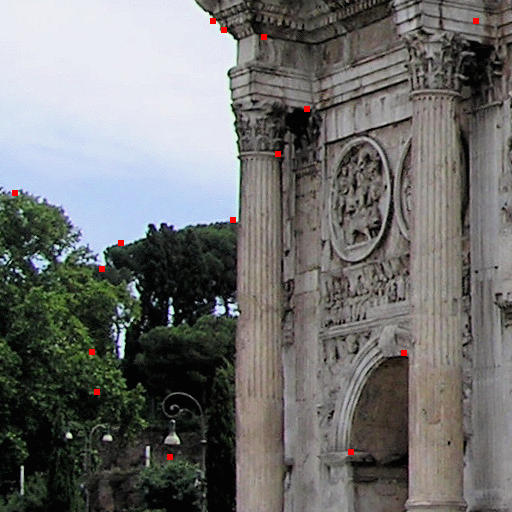

Arch 2: Interest Points
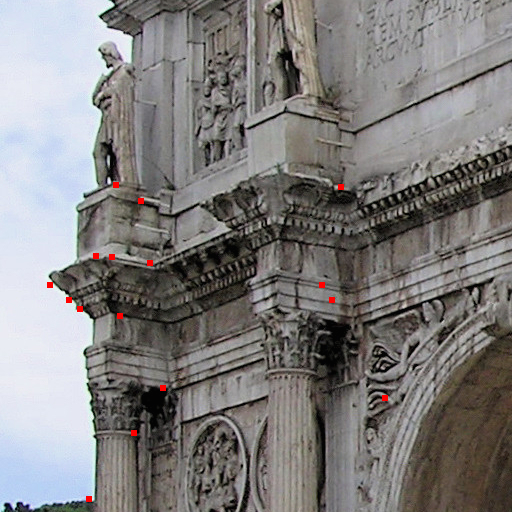

Compiled Image:
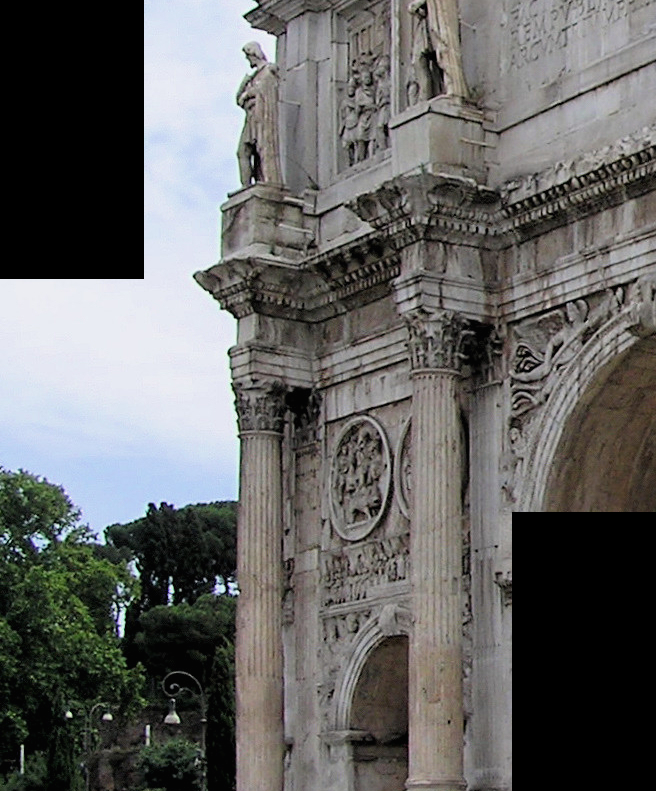

After a fair deal of trial and error, sigma values for each gaussian_filter call were found to produce this perfect match.

In [7]:
balloonImage1 = cv2.imread(balloonFile1)
balloonImage2 = cv2.imread(balloonFile2)  # Read both Images

BalloonImage1_copy = balloonImage1.copy()
BalloonImage2_copy = balloonImage2.copy()  # Create copies of both images

balloonCorners1 = harrisCorner(balloonImage1)
balloonCorners2 = harrisCorner(balloonImage2)  # Compute respective Harris Interest Points
BalloonCorners1 = np.array(balloonCorners1)
BalloonCorners2 = np.array(balloonCorners2)  # Store as array

for i in range(len(balloonCorners1)):  # Highlight all image 1 interest points by highlighting small window in red
    BalloonImage1_copy[BalloonCorners1[i, 0]-3:BalloonCorners1[i, 0]+3:, BalloonCorners1[i, 1]-3:BalloonCorners1[i, 1]+3] = [0, 0, 255]
cv2.imshow('', BalloonImage1_copy)
cv2.waitKey(0)

for i in range(len(balloonCorners2)):  # Highlight all image 2 interest points by highlighting small window in red
    BalloonImage2_copy[BalloonCorners2[i, 0]-3:BalloonCorners2[i, 0]+3:, BalloonCorners2[i, 1]-3:BalloonCorners2[i, 1]+3] = [0, 0, 255]
cv2.imshow('', BalloonImage2_copy)
cv2.waitKey(0)

balloonImgFull = mergeImages(balloonImage1, balloonImage2, balloonCorners1, balloonCorners2)
cv2.imshow('Compiled Image', balloonImgFull)
cv2.waitKey(0)  # Merge the two images and print the result
cv2.destroyAllWindows()  # Close all image windows

Outputs from this section:

Balloon 1: Interest Points
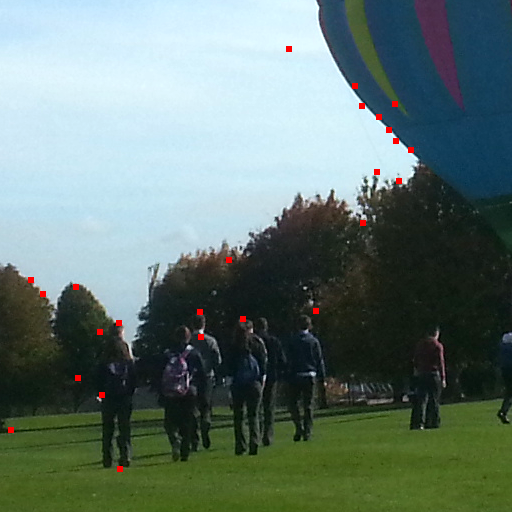

Balloon 2: Interest Points
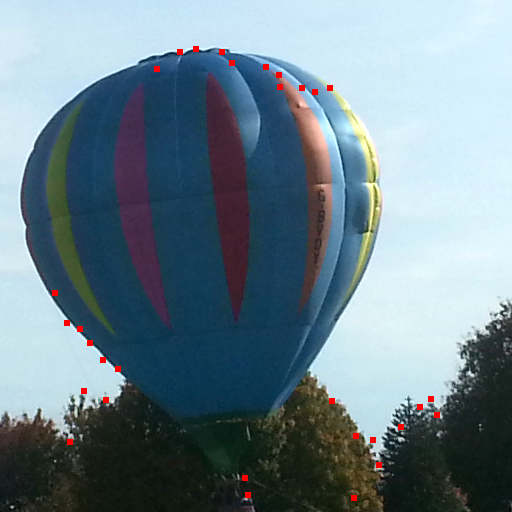

Compiled Image:
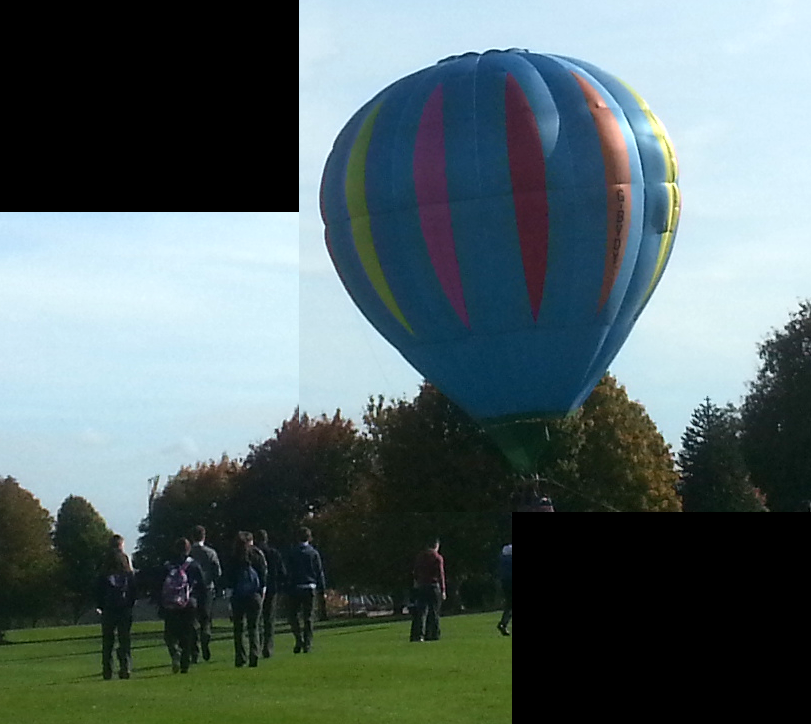

# Testing Rotation and Scale Variance

This proved to be a slow enough process, largy due to the O(n^2) runtime of the RANSAC implementation. Essentially the process is to rotate each test image and run the algorithm again, then compare the outputs with those from the previous section. Next, to test scale varience, each test image must be blown up and shrunk, then the algorithm is tested again.

In [11]:
# Testing rotation variance
# Plan is to rotate each image through 270 deg in steps of 90 and inspect the performance of the algorithm

for i in range(1, 4):
    RotatedArch1 = np.rot90(archImage1, i)
    RotatedArch2 = np.rot90(archImage2, i)

    ArchImage1_copy = RotatedArch1.copy()
    ArchImage2_copy = RotatedArch2.copy()  # Create copies of both images

    archCorners1 = harrisCorner(RotatedArch1)
    archCorners2 = harrisCorner(RotatedArch2)  # Compute respective Harris Interest Points
    ArchCorners1 = np.array(archCorners1)
    ArchCorners2 = np.array(archCorners2)  # Store as array

    for i in range(len(archCorners1)):  # Highlight all image 1 interest points by highlighting small window in red
        ArchImage1_copy[ArchCorners1[i, 0]-3:ArchCorners1[i, 0]+3:, ArchCorners1[i, 1]-3:ArchCorners1[i, 1]+3] = [0, 0, 255]
    cv2.imshow('', ArchImage1_copy)
    cv2.waitKey(0)

    for i in range(len(archCorners2)):  # Highlight all image 2 interest points by highlighting small window in red
        ArchImage2_copy[ArchCorners2[i, 0]-3:ArchCorners2[i, 0]+3:, ArchCorners2[i, 1]-3:ArchCorners2[i, 1]+3] = [0, 0, 255]
    cv2.imshow('', ArchImage2_copy)
    cv2.waitKey(0)

    archImgFull = mergeImages(RotatedArch1, RotatedArch2, archCorners1, archCorners2)
    cv2.imshow('Compiled Image', archImgFull)
    cv2.waitKey(0)  # Merge the two images and print the result
    cv2.destroyAllWindows()  # Close all image windows

for i in range(1, 4):
    RotatedBalloon1 = np.rot90(balloonImage1, i)
    RotatedBalloon2 = np.rot90(balloonImage2, i)

    BalloonImage1_copy = RotatedBalloon1.copy()
    BalloonImage2_copy = RotatedBalloon2.copy()  # Create copies of both images

    balloonCorners1 = harrisCorner(RotatedBalloon1)
    balloonCorners2 = harrisCorner(RotatedBalloon2)  # Compute respective Harris Interest Points
    BalloonCorners1 = np.array(balloonCorners1)
    BalloonCorners2 = np.array(balloonCorners2)  # Store as array

    for i in range(len(balloonCorners1)):  # Highlight all image 1 interest points by highlighting small window in red
        BalloonImage1_copy[BalloonCorners1[i, 0]-3:BalloonCorners1[i, 0]+3:, BalloonCorners1[i, 1]-3:BalloonCorners1[i, 1]+3] = [0, 0, 255]
    cv2.imshow('', BalloonImage1_copy)
    cv2.waitKey(0)

    for i in range(len(balloonCorners2)):  # Highlight all image 2 interest points by highlighting small window in red
        BalloonImage2_copy[BalloonCorners2[i, 0]-3:BalloonCorners2[i, 0]+3:, BalloonCorners2[i, 1]-3:BalloonCorners2[i, 1]+3] = [0, 0, 255]
    cv2.imshow('', BalloonImage2_copy)
    cv2.waitKey(0)

    balloonImgFull = mergeImages(RotatedBalloon1, RotatedBalloon2, balloonCorners1, balloonCorners2)
    cv2.imshow('Compiled Image', balloonImgFull)
    cv2.waitKey(0)  # Merge the two images and print the result
    cv2.destroyAllWindows()  # Close all image windows

Outputs:

Archs @ 90 deg

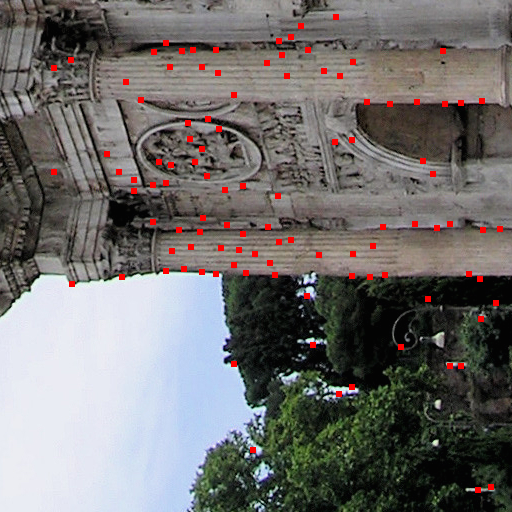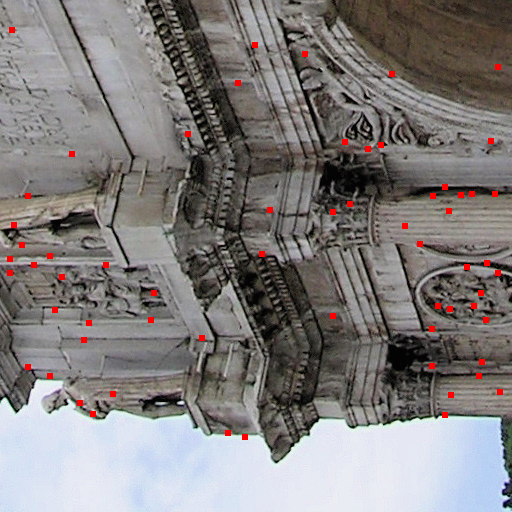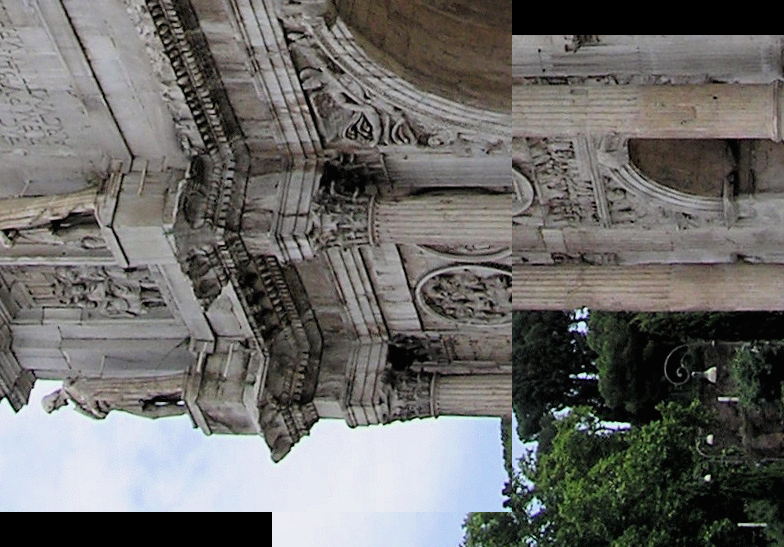

Archs @ 180 deg

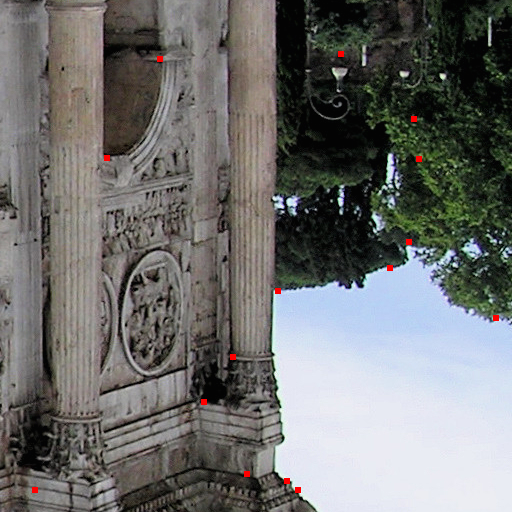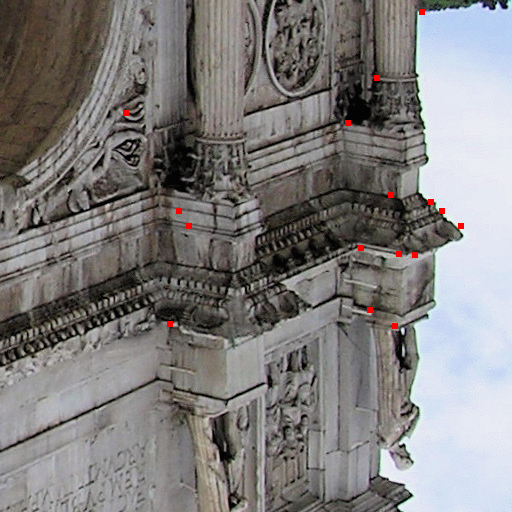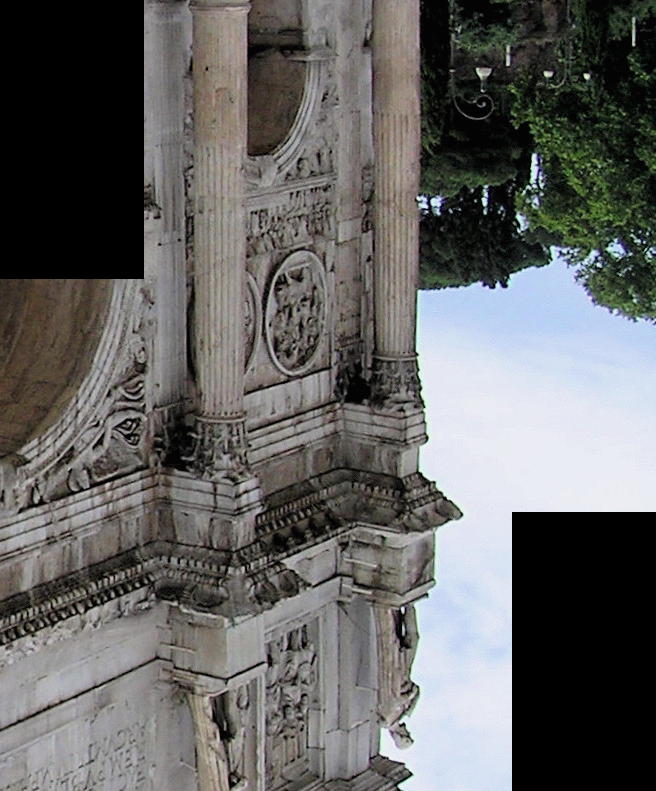

Archs @ 270 deg

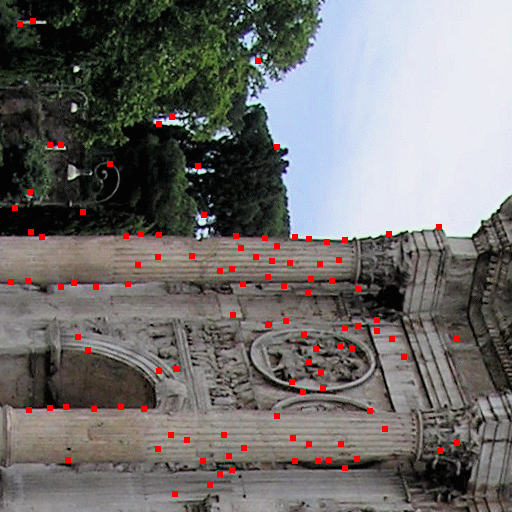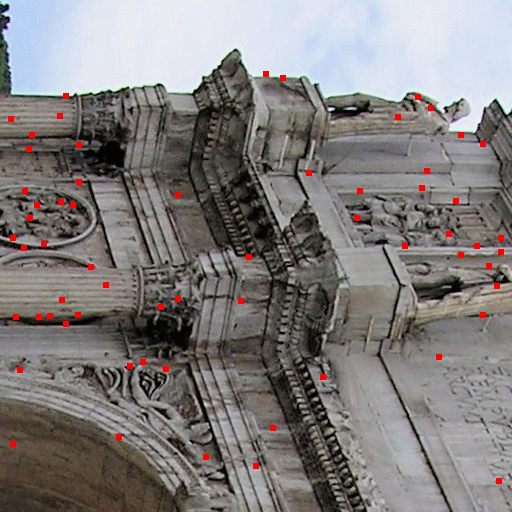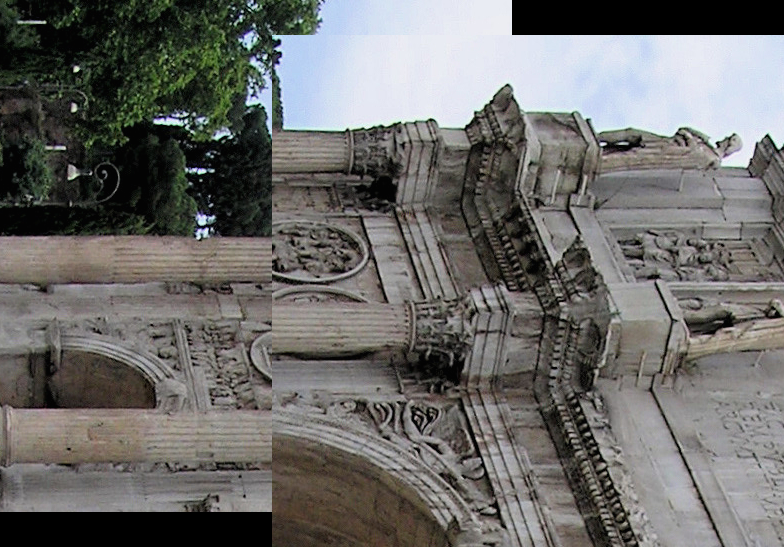

Balloons @ 90 deg

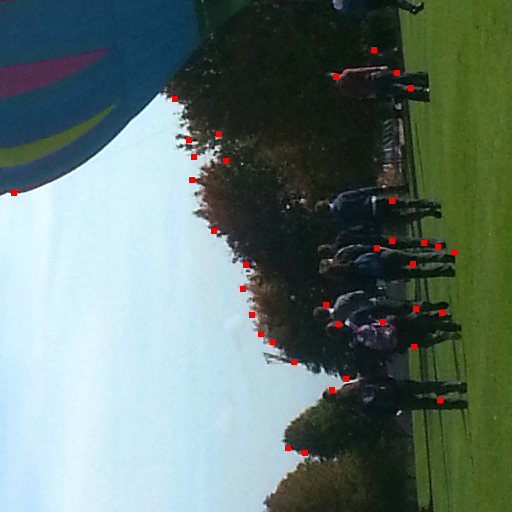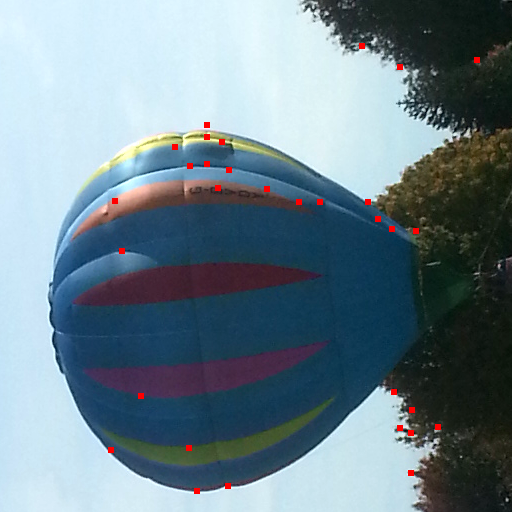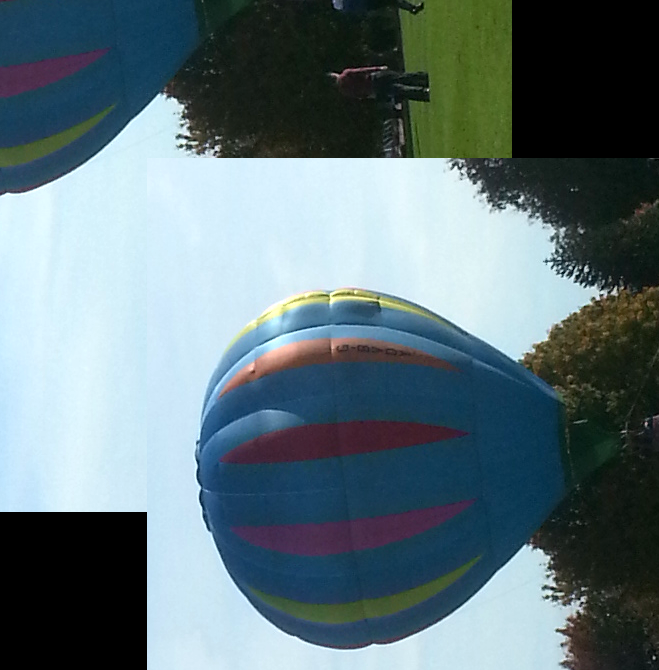

Balloons @ 180 deg

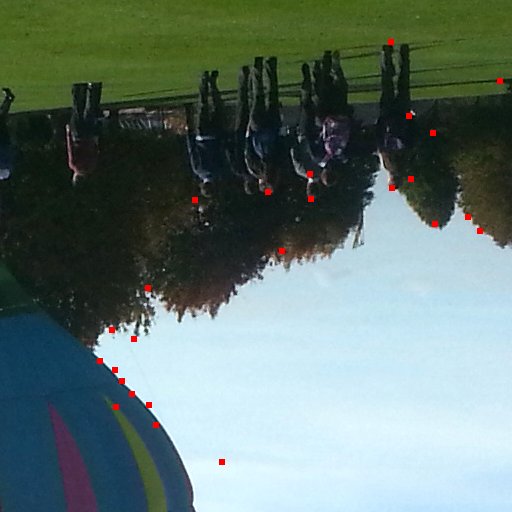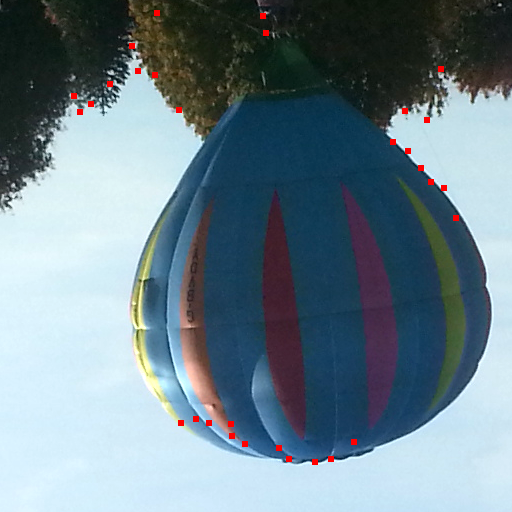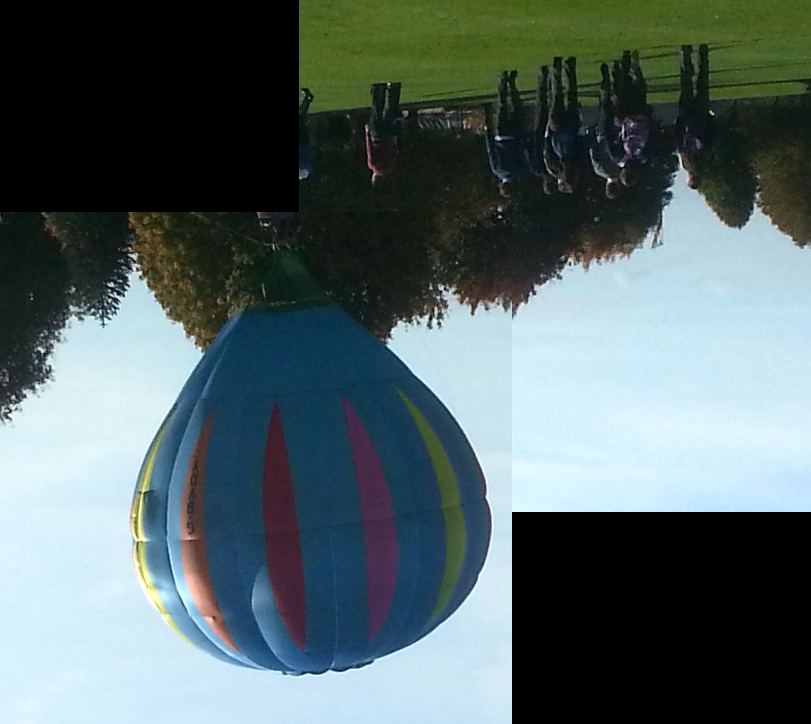

Balloons @ 270 deg

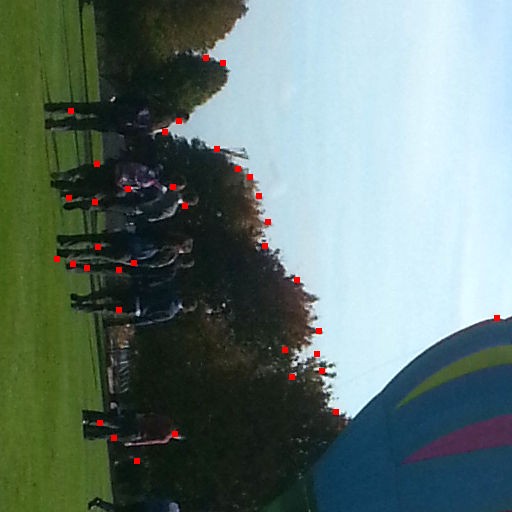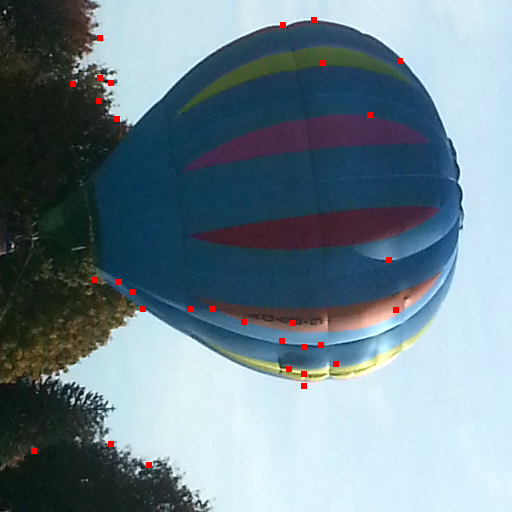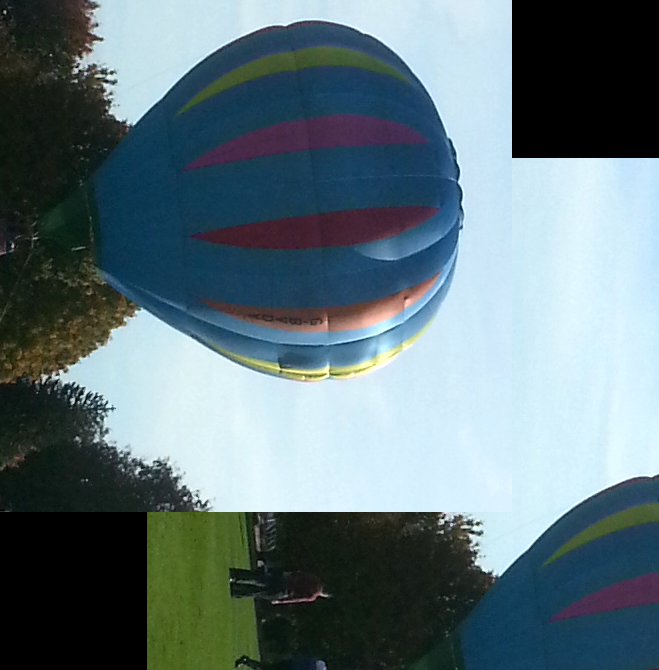

When the image is at integer multiples of 180 degress the operation seems to perfrom quite well, however when at 90 or 270 degrees the algorithm runs into some problems. In all likelihood this is due to the lack of robustness of the image-patch vector method of matching interest points. When rotated a certain way this part of the algorithm seems to become confused. The harris-corner detector doesn't seem to be phased so much by rotation, it can on occassion detect different corners than it would under normal image rotation, but the points it detects are still mostly corners (one balloon image I believe shows a corner in a largely flat region, so it's not quite perfect)

In [12]:
# Testing scale variance
# For this section the input images will be run through the algorithm at 0.5 and 1.5 times zoom.
# Each set of outputs will be plotted and compared with the original images.

Arch1_zm = clipped_zoom(archImage1, 0.5)
Arch2_zm = clipped_zoom(archImage2, 0.5)

ArchImage1_copy = Arch1_zm.copy()
ArchImage2_copy = Arch2_zm.copy()  # Create copies of both images

archCorners1 = harrisCorner(Arch1_zm)
archCorners2 = harrisCorner(Arch2_zm)  # Compute respective Harris Interest Points
ArchCorners1 = np.array(archCorners1)
ArchCorners2 = np.array(archCorners2)  # Store as array

for i in range(len(archCorners1)):  # Highlight all image 1 interest points by highlighting small window in red
    ArchImage1_copy[ArchCorners1[i, 0]-3:ArchCorners1[i, 0]+3:, ArchCorners1[i, 1]-3:ArchCorners1[i, 1]+3] = [0, 0, 255]
cv2.imshow('', ArchImage1_copy)
cv2.waitKey(0)

for i in range(len(archCorners2)):  # Highlight all image 2 interest points by highlighting small window in red
    ArchImage2_copy[ArchCorners2[i, 0]-3:ArchCorners2[i, 0]+3:, ArchCorners2[i, 1]-3:ArchCorners2[i, 1]+3] = [0, 0, 255]
cv2.imshow('', ArchImage2_copy)
cv2.waitKey(0)

archImgFull = mergeImages(Arch1_zm, Arch2_zm, archCorners1, archCorners2)
cv2.imshow('Compiled Image', archImgFull)
cv2.waitKey(0)  # Merge the two images and print the result
cv2.destroyAllWindows()  # Close all image windows

#---------------------------------------------------------------------------------------------------------------------------

Arch1_zm = clipped_zoom(archImage1, 1.5)
Arch2_zm = clipped_zoom(archImage2, 1.5)

ArchImage1_copy = Arch1_zm.copy()
ArchImage2_copy = Arch2_zm.copy()  # Create copies of both images

archCorners1 = harrisCorner(Arch1_zm)
archCorners2 = harrisCorner(Arch2_zm)  # Compute respective Harris Interest Points
ArchCorners1 = np.array(archCorners1)
ArchCorners2 = np.array(archCorners2)  # Store as array

for i in range(len(archCorners1)):  # Highlight all image 1 interest points by highlighting small window in red
    ArchImage1_copy[ArchCorners1[i, 0]-3:ArchCorners1[i, 0]+3:, ArchCorners1[i, 1]-3:ArchCorners1[i, 1]+3] = [0, 0, 255]
cv2.imshow('', ArchImage1_copy)
cv2.waitKey(0)

for i in range(len(archCorners2)):  # Highlight all image 2 interest points by highlighting small window in red
    ArchImage2_copy[ArchCorners2[i, 0]-3:ArchCorners2[i, 0]+3:, ArchCorners2[i, 1]-3:ArchCorners2[i, 1]+3] = [0, 0, 255]
cv2.imshow('', ArchImage2_copy)
cv2.waitKey(0)

archImgFull = mergeImages(Arch1_zm, Arch2_zm, archCorners1, archCorners2)
cv2.imshow('Compiled Image', archImgFull)
cv2.waitKey(0)  # Merge the two images and print the result
cv2.destroyAllWindows()  # Close all image windows

#---------------------------------------------------------------------------------------------------------------------------

Balloon1_zm = clipped_zoom(balloonImage1, 0.5)
Balloon2_zm = clipped_zoom(balloonImage2, 0.5)

BalloonImage1_copy = Balloon1_zm.copy()
BalloonImage2_copy = Balloon2_zm.copy()  # Create copies of both images

balloonCorners1 = harrisCorner(Balloon1_zm)
balloonCorners2 = harrisCorner(Balloon2_zm)  # Compute respective Harris Interest Points
BalloonCorners1 = np.array(balloonCorners1)
BalloonCorners2 = np.array(balloonCorners2)  # Store as array

for i in range(len(balloonCorners1)):  # Highlight all image 1 interest points by highlighting small window in red
    BalloonImage1_copy[BalloonCorners1[i, 0]-3:BalloonCorners1[i, 0]+3:, BalloonCorners1[i, 1]-3:BalloonCorners1[i, 1]+3] = [0, 0, 255]
cv2.imshow('', BalloonImage1_copy)
cv2.waitKey(0)

for i in range(len(balloonCorners2)):  # Highlight all image 2 interest points by highlighting small window in red
    BalloonImage2_copy[BalloonCorners2[i, 0]-3:BalloonCorners2[i, 0]+3:, BalloonCorners2[i, 1]-3:BalloonCorners2[i, 1]+3] = [0, 0, 255]
cv2.imshow('', BalloonImage2_copy)
cv2.waitKey(0)

balloonImgFull = mergeImages(Balloon1_zm, Balloon2_zm, balloonCorners1, balloonCorners2)
cv2.imshow('Compiled Image', balloonImgFull)
cv2.waitKey(0)  # Merge the two images and print the result
cv2.destroyAllWindows()  # Close all image windows

#---------------------------------------------------------------------------------------------------------------------------

Balloon1_zm = clipped_zoom(balloonImage1, 1.5)
Balloon2_zm = clipped_zoom(balloonImage2, 1.5)

BalloonImage1_copy = Balloon1_zm.copy()
BalloonImage2_copy = Balloon2_zm.copy()  # Create copies of both images

balloonCorners1 = harrisCorner(Balloon1_zm)
balloonCorners2 = harrisCorner(Balloon2_zm)  # Compute respective Harris Interest Points
BalloonCorners1 = np.array(balloonCorners1)
BalloonCorners2 = np.array(balloonCorners2)  # Store as array

for i in range(len(balloonCorners1)):  # Highlight all image 1 interest points by highlighting small window in red
    BalloonImage1_copy[BalloonCorners1[i, 0]-3:BalloonCorners1[i, 0]+3:, BalloonCorners1[i, 1]-3:BalloonCorners1[i, 1]+3] = [0, 0, 255]
cv2.imshow('', BalloonImage1_copy)
cv2.waitKey(0)

for i in range(len(balloonCorners2)):  # Highlight all image 2 interest points by highlighting small window in red
    BalloonImage2_copy[BalloonCorners2[i, 0]-3:BalloonCorners2[i, 0]+3:, BalloonCorners2[i, 1]-3:BalloonCorners2[i, 1]+3] = [0, 0, 255]
cv2.imshow('', BalloonImage2_copy)
cv2.waitKey(0)

balloonImgFull = mergeImages(Balloon1_zm, Balloon2_zm, balloonCorners1, balloonCorners2)
cv2.imshow('Compiled Image', balloonImgFull)
cv2.waitKey(0)  # Merge the two images and print the result
cv2.destroyAllWindows()  # Close all image windows

C:\Users\Fierce-PC\Anaconda3\lib\site-packages\scipy\ndimage\interpolation.py:600: UserWarning: From scipy 0.13.0, the output shape of zoom() is calculated with round() instead of int() - for these inputs the size of the returned array has changed.
  "the returned array has changed.", UserWarning)


Output:

Arch 1 (x0.5 scale)
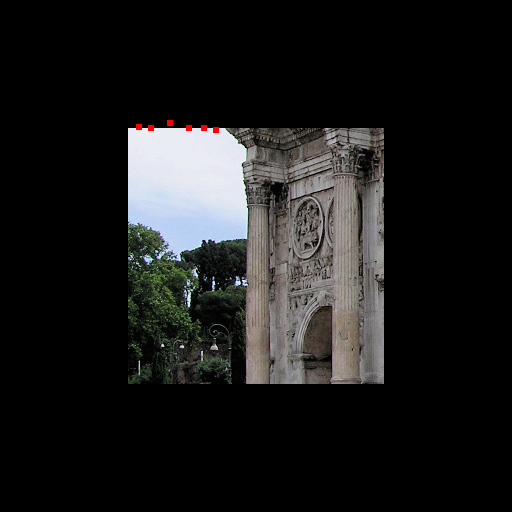

Arch 2 (x0.5 scale)
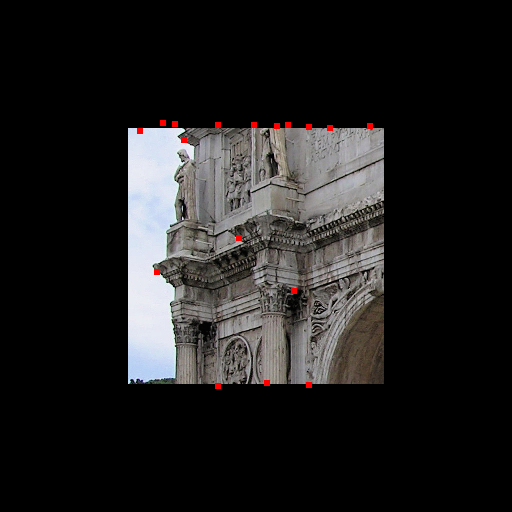

Compiled:
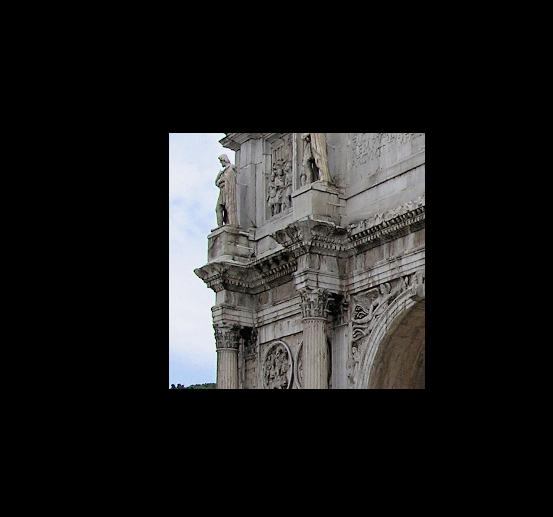

Arch 1 (x1.5 scale)
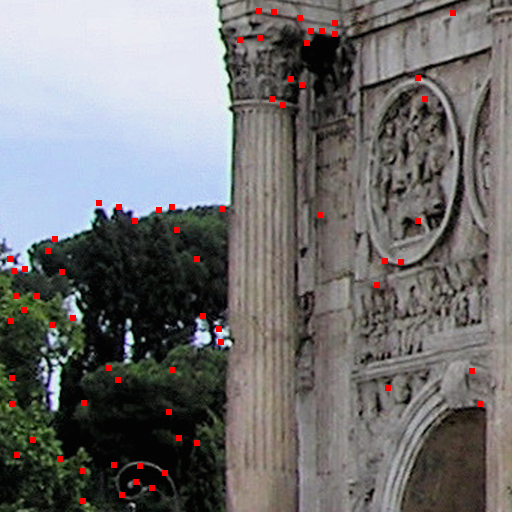

Arch 2 (x1.5 scale)
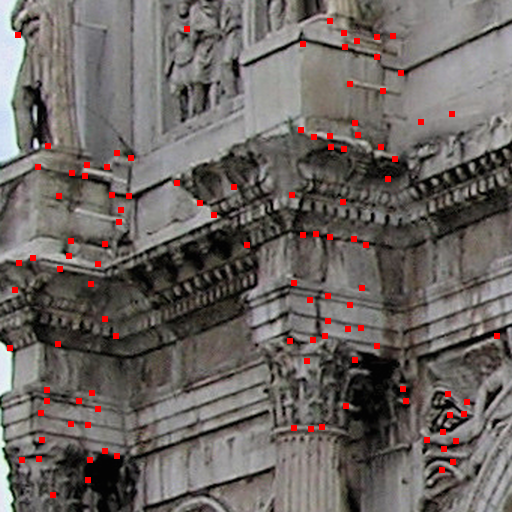

Compiled:
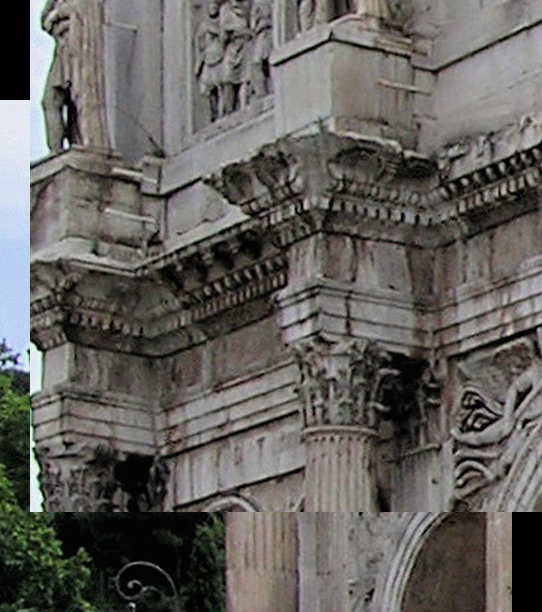

Balloon 1 (x0.5 scale)
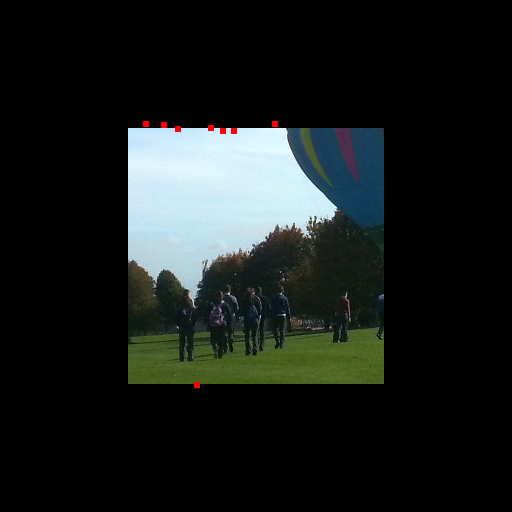

Balloon 2 (x0.5 scale)
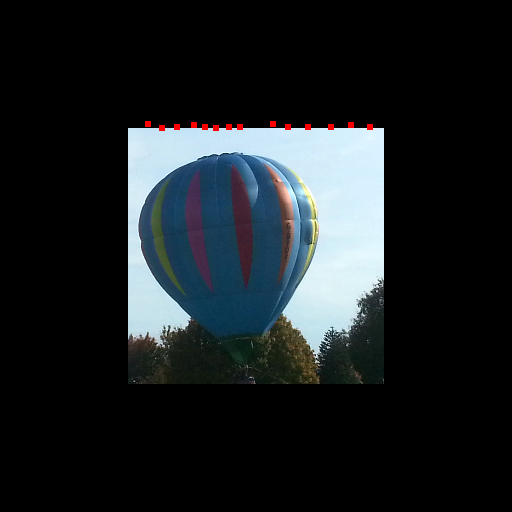

Compiled
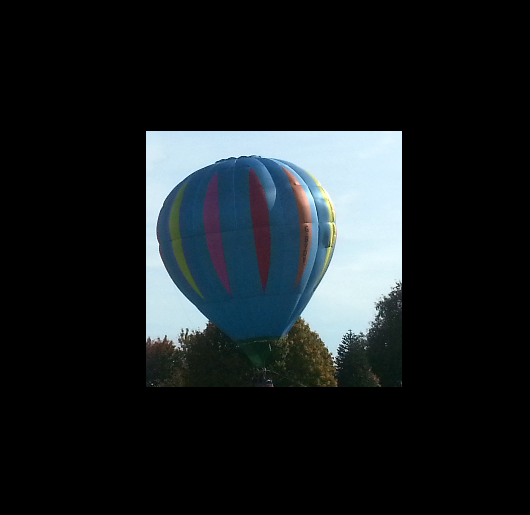

Balloon 1 (x1.5 scale)
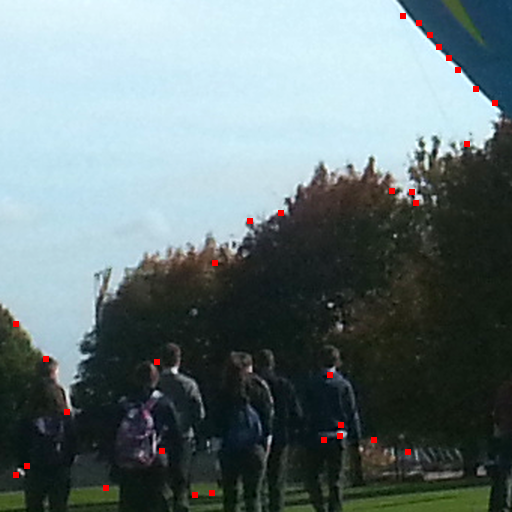

Balloon 2 (x1.5 scale)
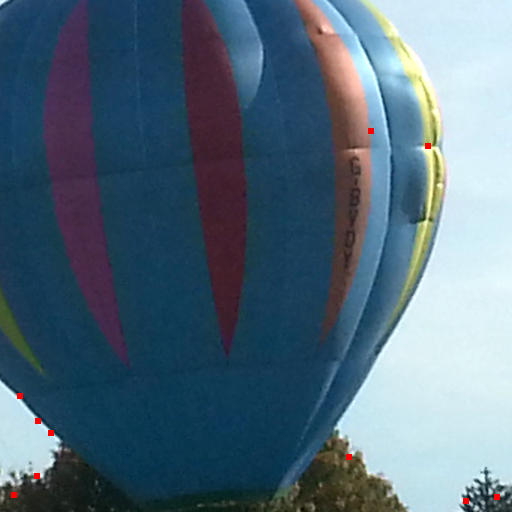

Compiled
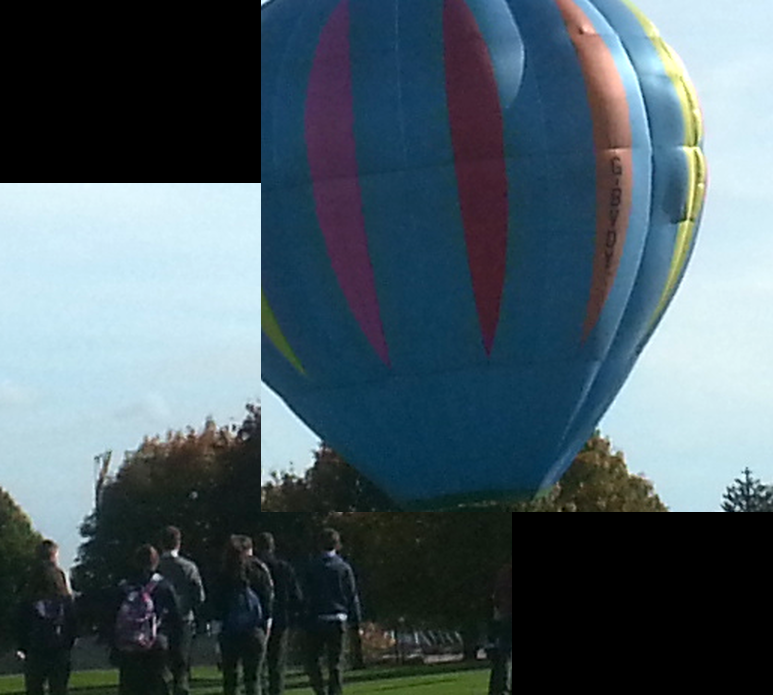


Perhaps the scaling could have been performed differently to achieve more flattering results, yet some observations can still be made about the performance of this code.

Firstly, when the image is shrunk the algorithm tends to focus more on the edges where the image turns to all black. This could have been aliviated if the image had been cropped after shrinking, regardless of this the in-image detection proved worse. Hense the compiled image looks pretty bad on both counts.

Secondly, when zoomed in the algorithm has difficulty matching interest points together. This is to be expected, as it is in fact possible that under enhancement corresponding points are lost. Nonetheless the algorithm does its best to match points together, and doesn't do all too terribly in fact.

# Review

The number of tests performed does yield quiet a few observations about this particular implementation of the Harris-Corner detection for image stitching. At the outset headings were listyed for the review, so let's revisit those:

Runtime:

The actual Harris-Corner detection bit runs in near real time, given that there are very few interpreted loops running. The performance does vary rather substantially with the relative sigma values used in the guassian_filter calls, but largely the poitns detected are indeed corners. The image stitching part can be very slow or reasonably fast, depending on the inputs. If there are a lot of fairly similar point in the input images (ie: a lot of candidate translations) this section can take a few minutes to run. Largely due to the implementation of RANSAC in this code. and embedded interpreted loop is always going to be slow, but this is the price paid for being exhaustive.
    
Robustness:

Oddly this implementation proved to be very sensitive to the sigma values used for the guassian_filter calls, but I don't believe that's the fault of the Harris corner detection. It's more likely to be an issue with the image-patch method of interest-point matching. Other students in the class used other methods of comparrison, for example one student didn't use the dot product as the comparritor, instead doing some manner of differencing and then averaging. This appeared to be far more robust under testing, so perhaps this is where the issue lies in my implementation.

Output-Credibility:

This seemed to vary from image to image, which in a way ties into robustness. The Balloon image had far fewer corners in the foreground, which seemed to cause some issues for the algorithm. There were minor in the first runs, however there was always some displacement issue. Under more robust methods of interest-point matching perhaps this issue would begin to disappear.